### Carga de módulos

In [10]:
import cv2
import numpy as np
import math
import time
from sklearn import svm
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from sklearn.svm import SVC
from joblib import dump, load
from imutils.object_detection import non_max_suppression
from imutils import paths
import glob
import os
import pathlib

### Carga del descriptor HoG+SVM

In [11]:
# Cargo los modelos ya entrenados para detectar peatones

# Es un modelo entrenado con todos los datos (carpetas de train y test), y los parámetros utilizados
# Fueron los mejores obtenidos de la exploración de hyperparámetros
# -kernel: rbf, C: 10, gamma:0.01, probability: True

# El parámetro probability me permite calcular una probabilidad para la predicción, la cual usaré para
# refinar las detecciones de peatones

hog_clf = load('HOGbest_clf.joblib')

### Función para el cálculo de las pirámides de imágenes

In [12]:
def get_pyramid(img):

    pyramid = [img] # Asigno la imagen sin escala como primer elemento
    new_level = img # Imagen sobre la que ire realizando las disminuciones de tamaño

    while np.shape(new_level)[0] >= 128 and np.shape(new_level)[1] >= 64:
        new_level = cv2.GaussianBlur(src=new_level, ksize=(7, 7), sigmaX=1)
        # 0.8333333 is 1 / 1.2
        new_level = cv2.resize(new_level, dsize=(0, 0), fx=0.8333333, fy=0.8333333)
        pyramid.append(new_level)
    return pyramid

imagen = cv2.imread("images/person_120.bmp", cv2.IMREAD_COLOR)

# Calculo la pirámide para la imagen
piramide = get_pyramid(imagen)

In [13]:
def piramide_HOG(piramide_img, pred_thr = 0.9):
    """
    Función para la detección de peatones utilizando el descriptor HoG y una SVM
    
    Parámetros:
     - piramide_img: piramide imágenes
     - pred_thr: thresold de la probabilidad para guardar una deteccion como peaton
     
    Retorna:
     - peatones: lista de listas con las detecciones
    """
    
    # Creo el descriptor para la imagen
    hog = cv2.HOGDescriptor()

    # Imagen sin escalar
    img_sin_escala = piramide_img[0]

    # Variables auxiliares
    cantidad = 0
    peatones = [] # Aquí guardo todas las detecciones

    # Itero las imagenes de la piramide
    for index in range(len(piramide_img)):

        # Obtengo la escala y la imagen
        imgp = piramide_img[index]
        # Calculo la escala de la imagen, a partir del tamaño de la original
        escala = imgp.shape[0] / img_sin_escala.shape[0]

        # Voy a ir desplazandome por la imagen
        alto_maximo = imgp.shape[0]
        ancho_maximo = imgp.shape[1]

        # Itero el alto
        for wy in np.arange(0, alto_maximo - 128, 32):
            # Itero el ancho
            for wx in np.arange(0, ancho_maximo - 64, 32):

                # Obtengo la porcion de imagen 128x64
                cropped = imgp[wy:wy+128, wx:wx+64]
                
                # Calculo el hog
                h = hog.compute(cropped)
                # Lo paso a 1 dimension
                h2 = h.reshape((1, -1))
                
                # Pruebo si hay un peaton
                pred = hog_clf.predict(h2)
                # Calculo las probabilidades de las dos clases
                predprob = hog_clf.predict_proba(h2)
                
                # Si la prediccion de peaton es positiva y supera el threshold
                if pred == 1 and predprob[0][1] > pred_thr:
                    # Guardo la posicion de la deteccion para graficar
                    detectado = [] # Genero lista vacia
                    if escala < 1:
                        detectado.append(wx/escala)
                        detectado.append(wy/escala)
                        detectado.append((wx/escala)+(64/escala))
                        detectado.append((wy/escala)+(128/escala))
                    else:
                        detectado.append(wx)
                        detectado.append(wy)
                        detectado.append(wx+64)
                        detectado.append(wy+128)
                    peatones.append(detectado) # Lo agrego a la lista general
                    cantidad += 1              # Cuento un peaton más
    return peatones


### Detecciones con HoG + SVM

In [14]:
# Busco los peatones y los marcpo

peatones_encontrados = piramide_HOG(piramide)
copia_hog = imagen.copy()
for peatonf in peatones_encontrados:
    v1 = int(peatonf[0])
    v2 = int(peatonf[1])
    v3 = int(peatonf[2])
    v4 = int(peatonf[3])
    cv2.rectangle(copia_hog, (v1, v2), (v3, v4), (255,0,0), 2)

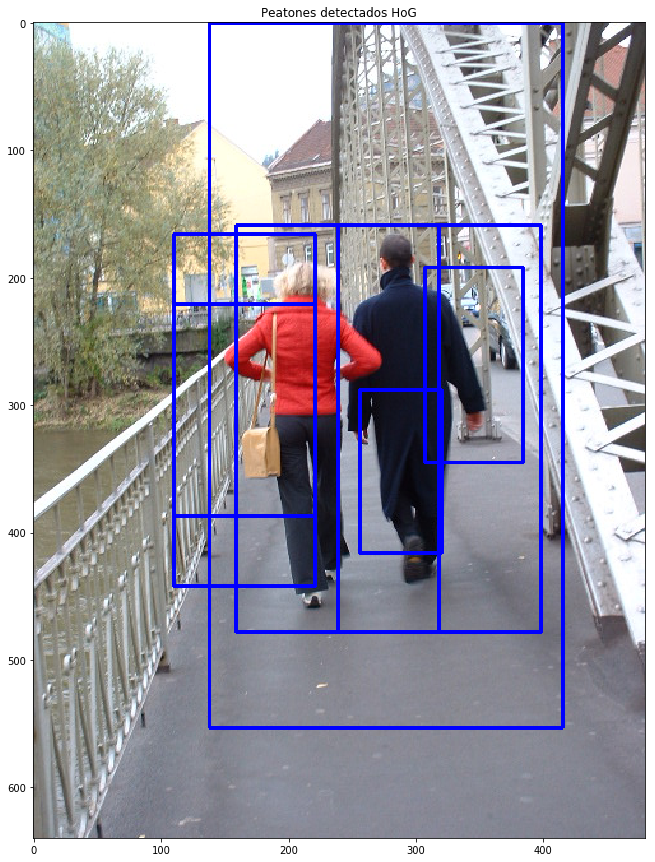

<Figure size 432x288 with 0 Axes>

In [15]:
# Grafico las detecciones del HoG comun
img_peatonesHoG = copia_hog[:,:,::-1]
fig = plt.figure(figsize = (15, 15))
ax = fig.add_subplot(111)
ax.imshow(img_peatonesHoG, interpolation='none')
ax.set_title('Peatones detectados HoG')
plt.show()
plt.savefig("img/HoG_escalas.png")

### Deteccion con HoG + SVM y filtrado de detecciones con NMS

In [16]:
copia_hog_NMS = imagen.copy()

rects = np.array([[x, y, w, h] for (x, y, w, h) in peatones_encontrados])
pick = non_max_suppression(rects, probs=None, overlapThresh=0.65)
print(pick)

# draw the final bounding boxes
for (xA, yA, xB, yB) in pick:
    cv2.rectangle(copia_hog_NMS, (xA, yA), (xB, yB), (0, 255, 0), 2)

[[138   0 415 553]]


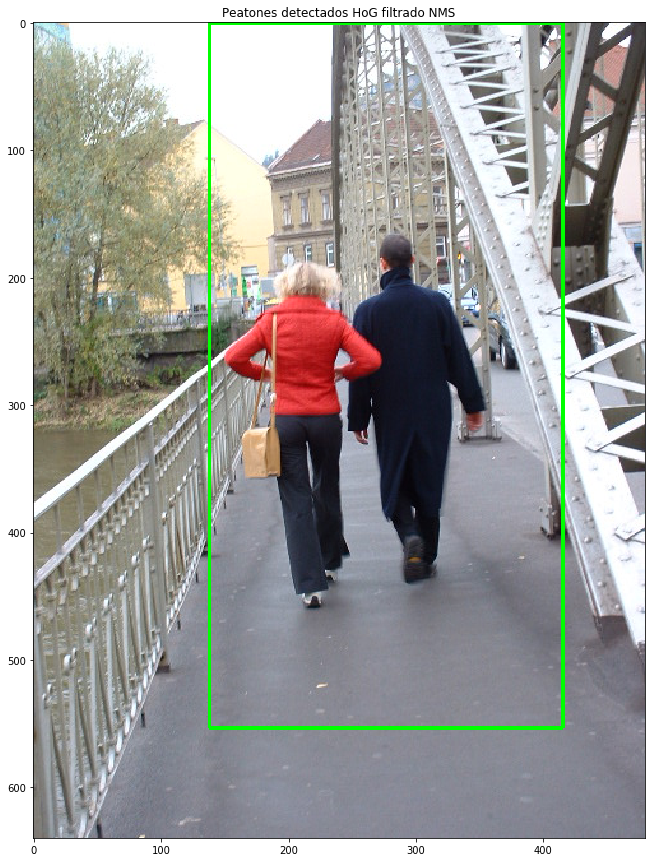

<Figure size 432x288 with 0 Axes>

In [17]:
# Grafico las detecciones
img_peatonesHoGNMS = copia_hog_NMS[:,:,::-1]
fig = plt.figure(figsize = (15, 15))
ax = fig.add_subplot(111)
ax.imshow(img_peatonesHoGNMS, interpolation='none')
ax.set_title('Peatones detectados HoG filtrado NMS')
plt.show()
plt.savefig("img/HoGNMS_escalas.png")

### Aplico sobre diferentes imágenes

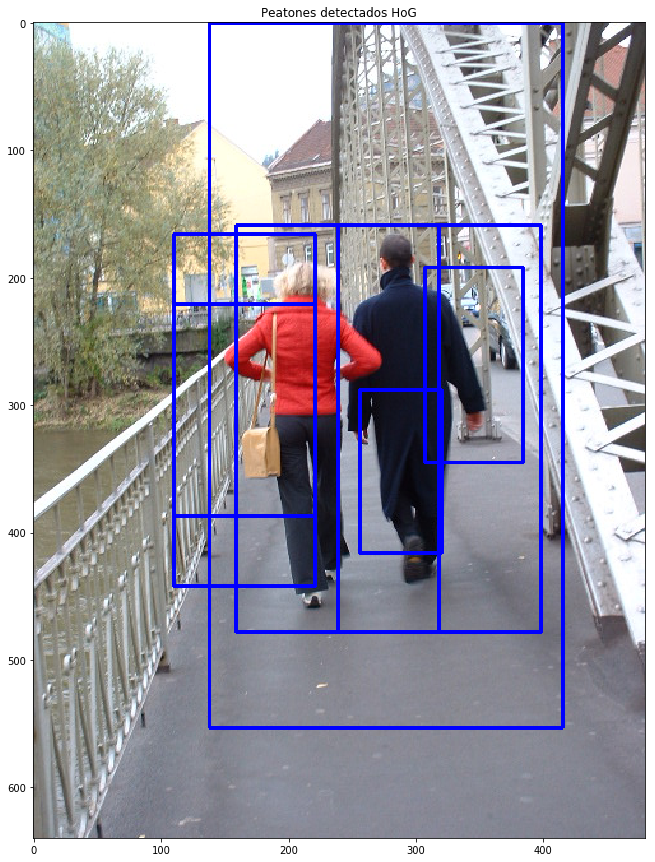

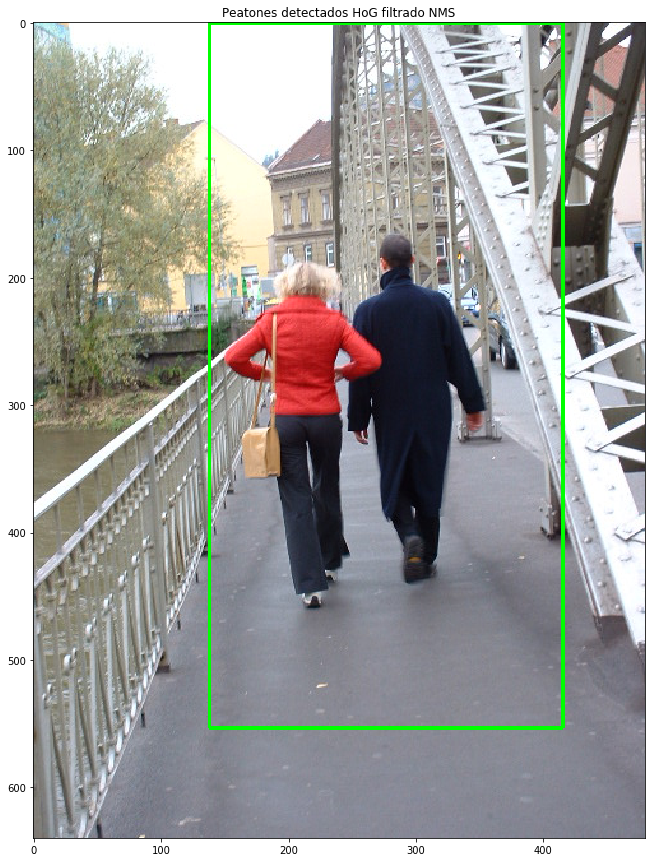

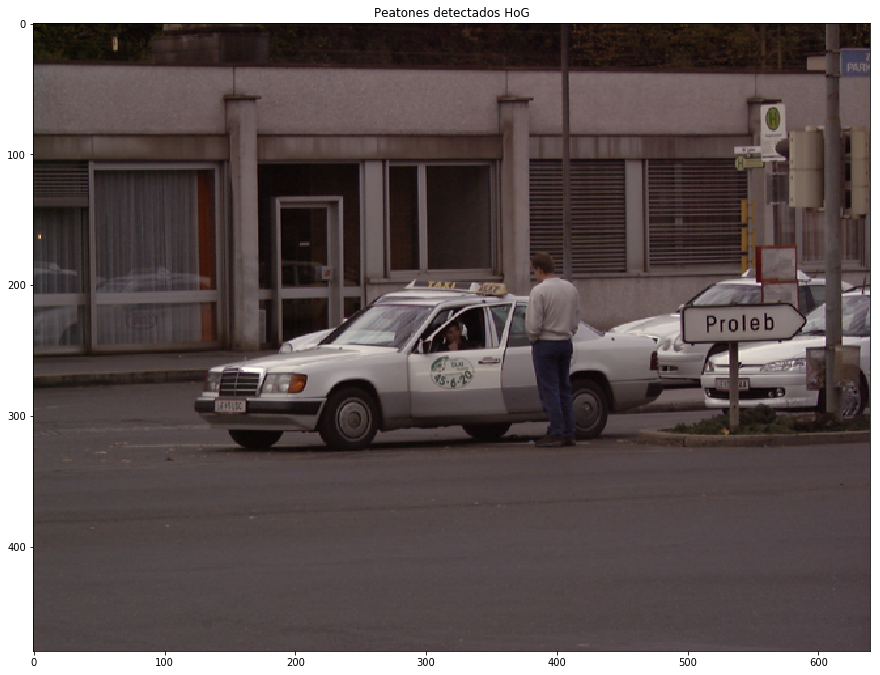

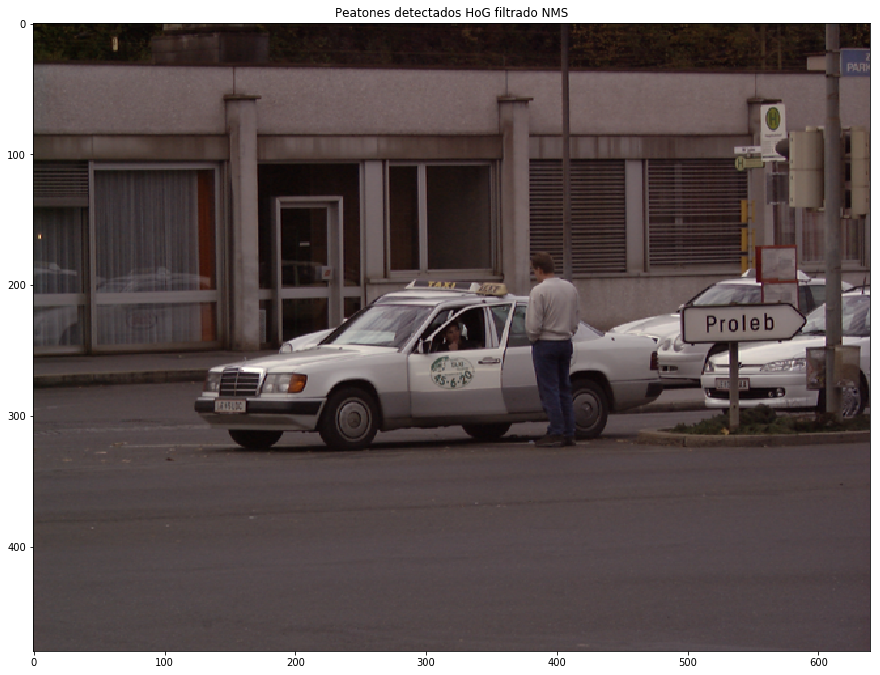

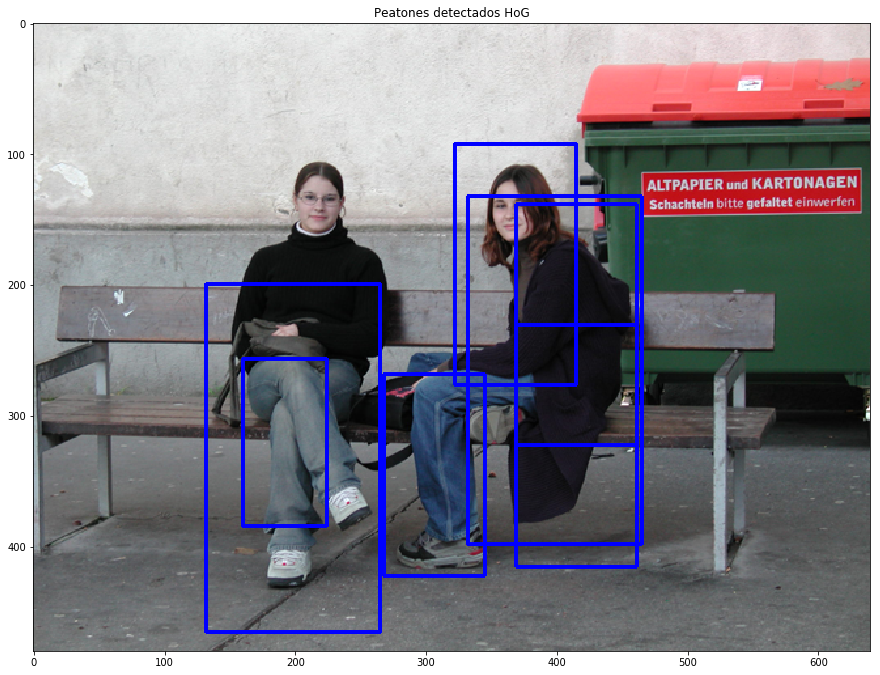

...

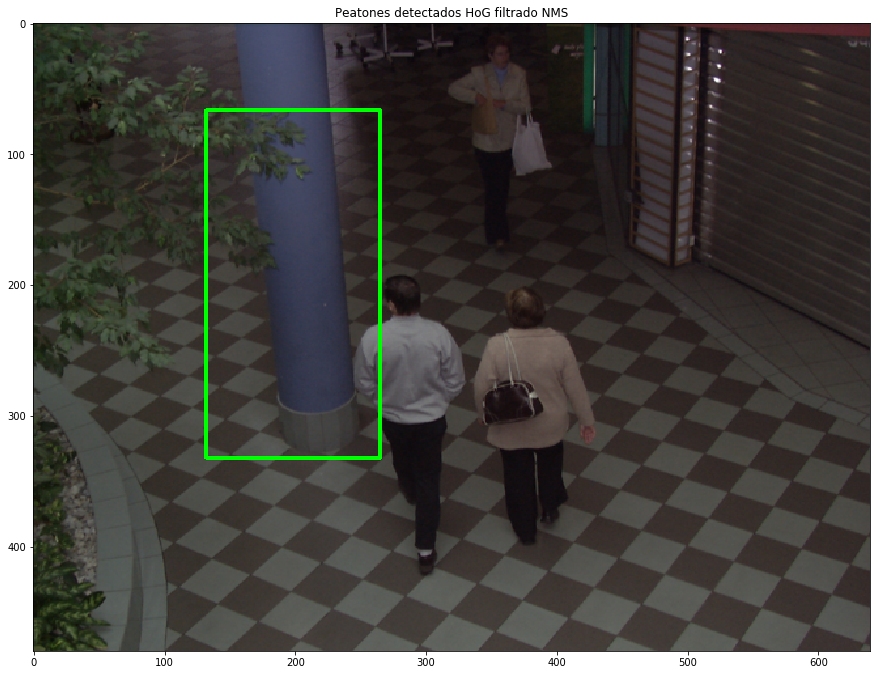

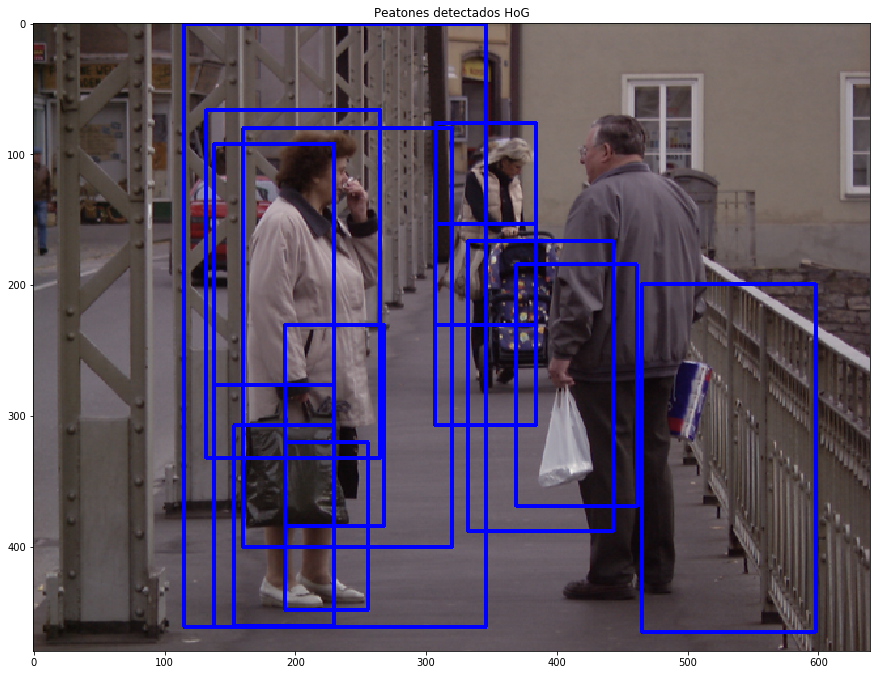

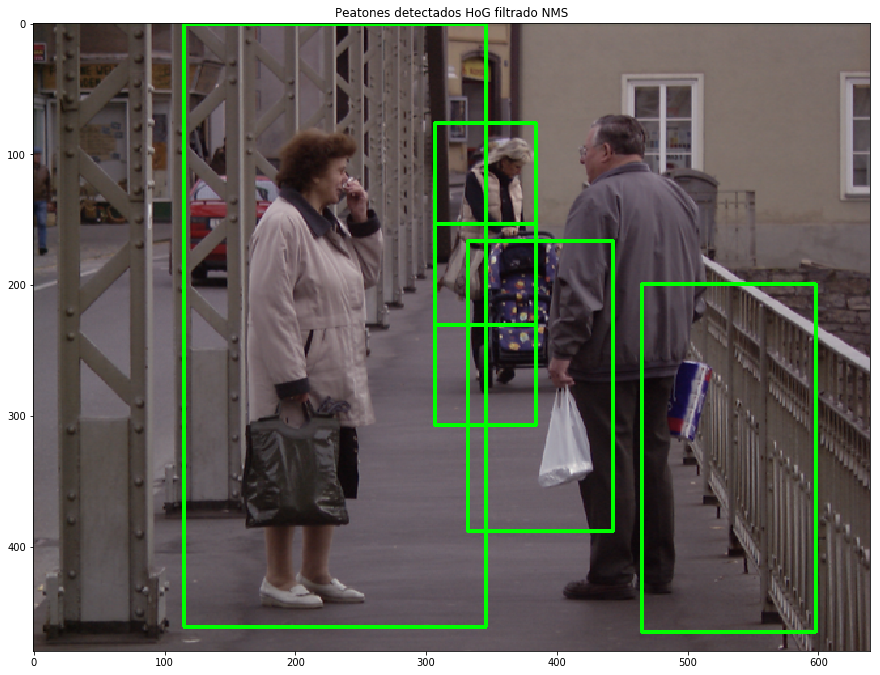

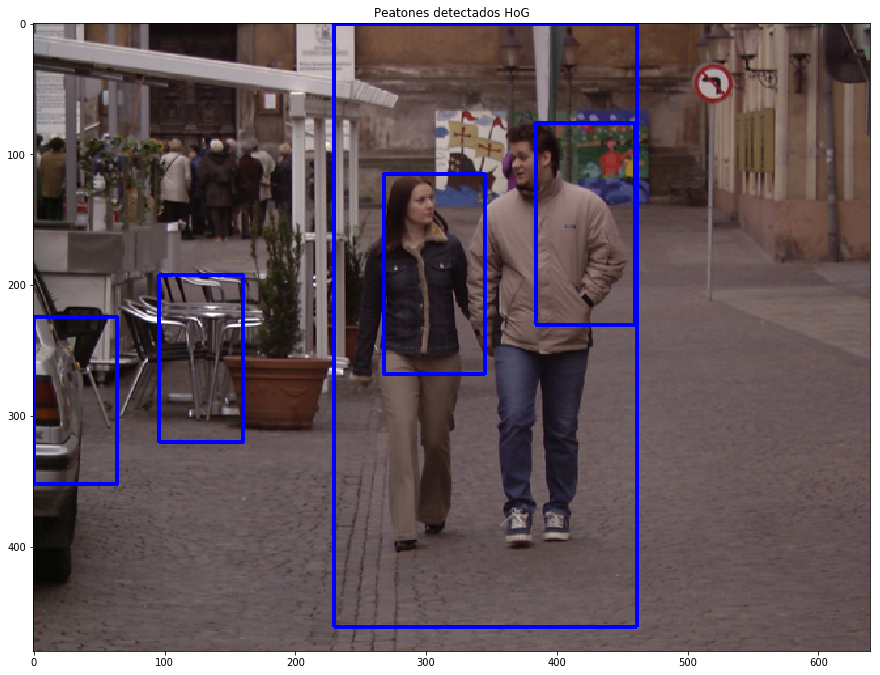

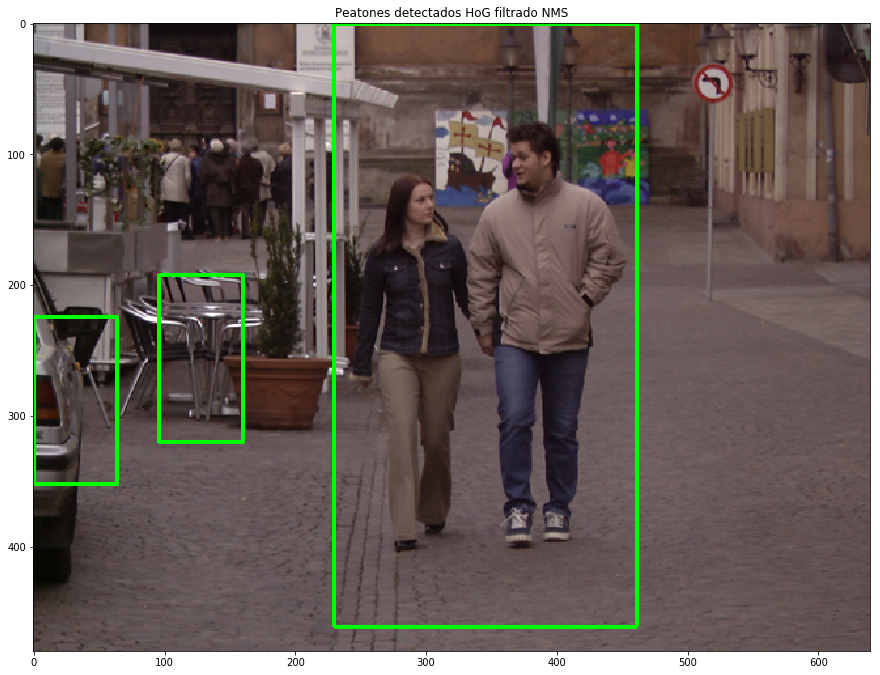

In [18]:
# Leo la carpeta con imágenes
cwd = os.getcwd()
for root, dirs, files in os.walk("images/"):
    for file in files:
        if file.endswith(".bmp"):
            image_path = os.path.join(cwd, root, file)
            
            # Leo la imagen
            imagen = cv2.imread(image_path, cv2.IMREAD_COLOR)
            
            # Hago los calculos y graifco
            piramide = get_pyramid(imagen)
            peatones_encontrados = piramide_HOG(piramide)
            copia_hog = imagen.copy()
            for peatonf in peatones_encontrados:
                v1 = int(peatonf[0])
                v2 = int(peatonf[1])
                v3 = int(peatonf[2])
                v4 = int(peatonf[3])
                cv2.rectangle(copia_hog, (v1, v2), (v3, v4), (255,0,0), 2)
            # Grafico las detecciones del HoG comun
            img_peatonesHoG = copia_hog[:,:,::-1]
            fig = plt.figure(figsize = (15, 15))
            ax = fig.add_subplot(111)
            ax.imshow(img_peatonesHoG, interpolation='none')
            ax.set_title('Peatones detectados HoG')
            plt.show()
            
            

            # Cálculo el NMS
            copia_hog_NMS = imagen.copy()
            rects = np.array([[x, y, w, h] for (x, y, w, h) in peatones_encontrados])
            pick = non_max_suppression(rects, probs=None, overlapThresh=0.65)

            # draw the final bounding boxes
            for (xA, yA, xB, yB) in pick:
                cv2.rectangle(copia_hog_NMS, (xA, yA), (xB, yB), (0, 255, 0), 2)
            # Grafico las detecciones
            img_peatonesHoGNMS = copia_hog_NMS[:,:,::-1]
            fig = plt.figure(figsize = (15, 15))
            ax = fig.add_subplot(111)
            ax.imshow(img_peatonesHoGNMS, interpolation='none')
            ax.set_title('Peatones detectados HoG filtrado NMS')
            plt.show()